# Local Geology of the Princeton Area

IN THE SPACE BELOW, WRITE OUT IN FULL AND THEN SIGN THE HONOR PLEDGE:

“I pledge my honor that I have not violated the honor code during this examination.”

**PRINT NAME**: 

If a fellow student has contributed significantly to this work, please acknowledge them here:

**Peer(s)**:                          

*Contribution:*


By uploading this assignment through Canvas, I sign off on the document below electronically.

----

## Part I: GeoExchange

Princeton needs heating and cooling 24/7/365 on our campus. In the winter, buildings are heated with steam. In the summer, they are cooled with chilled water. But, even on the coldest winter days, we still need to remove heat from the campus to cool lasers, electron microscopes, CT scan machines, computer facilities, and some building cores. And, even on the hottest summer days, we need to deliver heat to the campus for domestic hot water, dish washing, sterilizers, autoclaves, cage washers, and air‐ conditioning reheat for humidity control and comfort. There is a sizable need for simultaneous heating and cooling all year.

Princeton will use big tanks of hot and cold water and big geoexchange borefields for thermal energy storage. The thermal storage tanks hold a few million gallons each; large enough to deliver heating or cooling for several hours. The geoexchange wellfields are large enough to store an entire heating season of energy for the campus! Seasonal energy storage helps to address the mismatch between summer cooling demands and winter heating demands explored in exercises 3a to 3d.

Imagine it’s a hot August day and we’re running heat pumps to meet the campus cooling load. The heat pumps move heat out of the buildings and will have more than enough to satisfy all simultaneous heating needs. What will we do with the excess heat? First, we’ll use it to heat a few million gallons of water in a hot thermal storage tank that can be delivered to campus that night or several days later; whenever heating demand is higher. And what if we still need to remove heat from campus but don’t need it for months for to come? That’s were seasonal storage plays a role.

In [51]:
import pandas as pd
PU_Data = pd.read_excel('Files/Microgrid_PU_Data_8-31-2022.xlsx')

In [52]:
PU_Data

,Timestamp,"Campus Total Cooling Demand, Tons","Outdoor Air Temperature, F","Total Campus Steam Demand, Pounds Per Hour","Total Campus Power Demand, KW","Locational Marginal Price, $/MWH"
0,2020-07-01 00:00:00,6465.366,71.039,36663.306,12531.491,14.123596
1,2020-07-01 01:00:00,6457.861,69.605,36743.513,12325.745,15.380625
2,2020-07-01 02:00:00,6240.119,69.600,36930.052,12195.363,14.876885
3,2020-07-01 03:00:00,6126.111,69.286,36897.495,12146.217,14.004767
4,2020-07-01 04:00:00,5553.196,69.176,36063.303,12201.516,13.325767
...,...,...,...,...,...,...
17513,2022-06-30 20:00:00,6061.833,86.258,37043.694,17035.897,78.367859
17514,2022-06-30 21:00:00,5699.684,83.177,35135.220,17048.291,52.693565
17515,2022-06-30 22:00:00,5700.993,79.999,35613.224,16987.258,60.326447
17516,2022-06-30 23:00:00,5056.392,76.292,35493.236,16242.035,56.912426


In [53]:
PU_Data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17518 entries, 0 to 17517
Data columns (total 6 columns):
 #   Column                                      Non-Null Count  Dtype         
---  ------                                      --------------  -----         
 0   Timestamp                                   17518 non-null  datetime64[ns]
 1   Campus Total Cooling Demand, Tons           17518 non-null  float64       
 2   Outdoor Air Temperature, F                  17518 non-null  float64       
 3   Total Campus Steam Demand, Pounds Per Hour  17518 non-null  float64       
 4   Total Campus Power Demand, KW               17517 non-null  float64       
 5   Locational Marginal Price, $/MWH            17518 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 821.3 KB


- Btu delivered per pound of steam : 950 
- 1 Btu = 3,412  KWH
- Btu removed per Ton-Hour during cooling :  12,000 
- Assuming heating system is 80% efficient. Building heat addition is less than heating energy requirements in the system specifications due to inefficiencies.

In [54]:
PU_Data['Campus building heat addition, MW']=PU_Data['Total Campus Steam Demand, Pounds Per Hour']*950/3412/1000*0.8

In [56]:
PU_Data['Campus heat removal, MW'] = PU_Data['Campus Total Cooling Demand, Tons']*12000/3412/1000

In [57]:
PU_Data

,Timestamp,"Campus Total Cooling Demand, Tons","Outdoor Air Temperature, F","Total Campus Steam Demand, Pounds Per Hour","Total Campus Power Demand, KW","Locational Marginal Price, $/MWH","Campus building heat addition, MW","Campus heat removal, MW"
0,2020-07-01 00:00:00,6465.366,71.039,36663.306,12531.491,14.123596,8.166504,22.738685
1,2020-07-01 01:00:00,6457.861,69.605,36743.513,12325.745,15.380625,8.184370,22.712290
2,2020-07-01 02:00:00,6240.119,69.600,36930.052,12195.363,14.876885,8.225920,21.946491
3,2020-07-01 03:00:00,6126.111,69.286,36897.495,12146.217,14.004767,8.218668,21.545525
4,2020-07-01 04:00:00,5553.196,69.176,36063.303,12201.516,13.325767,8.032858,19.530584
...,...,...,...,...,...,...,...,...
17513,2022-06-30 20:00:00,6061.833,86.258,37043.694,17035.897,78.367859,8.251233,21.319460
17514,2022-06-30 21:00:00,5699.684,83.177,35135.220,17048.291,52.693565,7.826133,20.045782
17515,2022-06-30 22:00:00,5700.993,79.999,35613.224,16987.258,60.326447,7.932606,20.050386
17516,2022-06-30 23:00:00,5056.392,76.292,35493.236,16242.035,56.912426,7.905879,17.783325


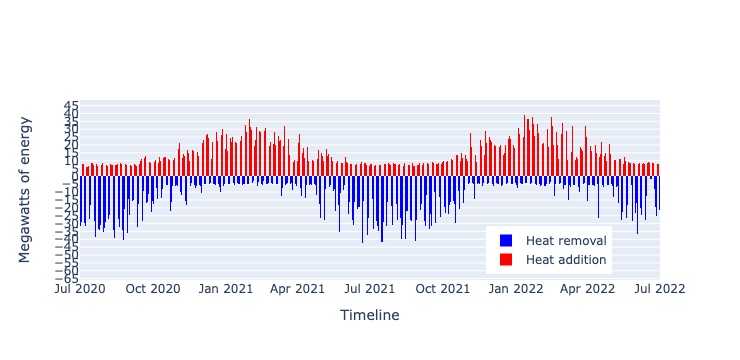

In [94]:
import plotly.graph_objects as go


fig = go.Figure(data=[go.Bar(
    name = 'Heat removal',
    x = PU_Data['Timestamp'],
    y = -PU_Data['Campus heat removal, MW'],
    marker_color='blue', marker_line_width=0
   ),
                       go.Bar(
    name = 'Heat addition',
    x = PU_Data['Timestamp'],
    y = PU_Data['Campus building heat addition, MW'],
    marker_color='red', marker_line_width=0
   )
])
 
fig.update_layout(xaxis_title='Timeline',yaxis_title='Megawatts of energy')
fig.update_layout(barmode='group',bargap=0.0,bargroupgap=0.0,
                   legend=dict(yanchor="top",y=0.3,xanchor="left",x=0.7),
                   yaxis=dict(dtick=5))
fig.show()

Annual energy data can inform us about how much energy is needed at peak moments, i.e., what equipment capacity is required. The data can also inform us about what seasonal storage capacity would be helpful.

Exercise #3a
How much energy was produced to heat the campus for a year? Express this in “Pounds of Steam” and convert to Megawatt‐Hours. Assume 950 Btus can be delivered to the conditioned space for every pound of steam.

A: 588,240,373 pounds of steam were produced to heat the campus for an average year. This equates to 163,783 Megawatt-Hours of heat sent from the plant to the campus.

Exercise #3b
If the campus steam system insulation is severely degraded and loses 20% of the heat that’s produced by the plant, how much energy did the campus buildings actually receive?

A: 470,592,299 pounds of steam were delivered to heat the buildings for a year.
This equates to 131,027 Megawatt-Hours of heat supply.

Exercise #3c
How much heat removal is needed to cool the campus for a year? Express this in “Ton‐Hours” and in equivalent Megawatt‐Hours.

A: 34,835,489 ton-hours are required to cool the campus for a year.
This equates to 122,516 Megawatt-Hours of cooling (heat removal).

SEASONAL THERMAL STORAGE ‐‐ GEOEXCHANGE

Typical geoexchange wellfields include hundreds of wells. We’re now drilling over a thousand geoexchange bores on campus, each 850 feet deep and each placed in a grid pattern spaced 20 feet apart. We’re installing a 1.5‐inch‐diameter U‐bend of HDPE plastic tube in each bore and grouting it in place for its entire depth. When we pump warm water from the heat pumps’ condensers down through the HDPE tubes, it will give up its heat through the grout into the surrounding rock. The rock under our campus at that depth is naturally 50‐55 degrees Fahrenheit, so water entering at 90 degrees will give up its heat to the rock and return to the surface at 60‐70 degrees. The earth becomes a heat sink all summer long. Over the course of the summer the rock gradually heats up, acting as a seasonal energy storage reservoir.

We will harvest heat from campus buildings all summer, preserve it for several months underground, and reclaim much of it in winter. Some heat will dissipate through the surrounding rock, but billions of pounds of warm rock will store an ample supply of heat that can be moved back to campus when it’s needed.

The following exercises consider whether an entire season of heat removed from campus could be stored in geoexchange wells below campus. What volume is required, and what kind of temperature change is implied. Each of these calculations is simplified to demonstrate the general concept of campus‐scale seasonal energy storage.

Exercise #5a
Using the campus’s Total Annual Cooling energy requirement calculated in Exercise 3c, convert the amount of heat removed from campus in a year from Ton‐hours to Btus.

A: 34.8 million ton-hours converts to 418 billion Btu heat rejected per year. This is how much energy is removed by the campus cooling system in a year.

Exercise #5b
Assume a rectangular geoexchange wellfield where the geoexchange wells are spaced in a grid pattern 20 feet from center‐to‐center and the geoexchange wells extend down 850 feet in the rock below campus. How many cubic feet of rock are associated with each geoexchange well?

A: The volume of rock associated with each geoexchange well is 340,000 cubic feet.

Exercise #5c
If the average density of rock is 165 pounds per cubic foot and there are 1000 wells in the geoexchange field, how many pounds of rock are associated with the wellfield?

The mass of rock associated with the wellfield is 56.1 billion pounds.

Based on your answers from 5a and 5c, how much heat energy would each pound of rock need to store to hold an entire year of heat removed from the campus?

A: Each pound of rock in the geoexchange array would have to store 7.45 Btus in order to hold the entire amount of heat removed from campus in a year by the cooling system.

Exercise #5e
Assume the specific heat of rock is 0.47 Btu/pound/degree F. How many degrees will the rock in the geoexchange array rise if an entire season of heat is stored? If the wellfield starts at 53 degrees F in the spring, what temperature will it reach by fall?

A: If all cooling energy removed from the campus in a year is stored in the geoexchange field with no heat removal and no losses, then the rock would rise 15.9 degrees. If it began at 53 degrees F in the early spring, it would rise to 68.9 degrees by the fall. During the winter this heat would be removed and the geoexchange field would cool again.

<img src="Images/geoexchange_overall.png" alt="drawing" width="100%"/>

Princeton’s district energy expansion project will include the use of bore holes situated beneath the university’s softball field, new buildings, and other campus spaces. The illustration here captures the essence of the geoexchange component. **Source:** Ted Borer

<img src="Images/borehole_drilling_1.png" alt="drawing" width="100%"/> 
<img src="Images/borehole_drilling_2.png" alt="drawing" width="100%"/>

Princeton is installing over a thousand geoexchange bores on campus. The bores are between 600 and 850 feet deep. 1 ½” diameter HDPE tube is inserted in the wells in a U‐bend to carry water down to the bottom and back to the surface again. As the water is pumped through the wells it will give up heat to the rock (summer) or pick up heat from the rock (winter). **Source:** Whiting-Turner

Source: [USGS](https://mrdata.usgs.gov/geology/state/state.php?state=NJ)

In [3]:
import geopandas as gpd
import pandas as pd

NJ_directory = '../Field_Trip_2_Geophysics/Files/NJ'
NJ_lith = pd.read_csv(NJ_directory+'/NJ_lith.csv')
NJ_units = pd.read_csv(NJ_directory+'/NJ_units.csv')

In [4]:
NJ_lith

,unit_link,lith_rank,lith1,lith2,lith3,lith4,lith5,low_lith,lith_form,lith_com
0,NJCAh;6,Minor,Sedimentary,Clastic,Sandstone,NaN,NaN,Sandstone,NaN,
1,NJCAh;6,Minor,Sedimentary,Clastic,Conglomerate,NaN,NaN,Conglomerate,NaN,
2,NJCAh;6,Major,Metamorphic,Metasedimentary,Metaclastic,Quartzite,NaN,Quartzite,NaN,
3,NJCAh;8,Major,Metamorphic,Metasedimentary,Metaclastic,Quartzite,NaN,Quartzite,Bed,"Medium- to light-gray, fine- to coarse-grained..."
4,NJCAh;8,Minor,Sedimentary,Clastic,Sandstone,Arkose,NaN,Arkose,Bed,arkosic sandstone
...,...,...,...,...,...,...,...,...,...,...
442,NJZch;11,"Indeterminate, major",Metamorphic,Metaigneous,Metavolcanic,Metarhyolite,NaN,Metarhyolite,Bed,metarhyolite
443,NJZd;11,Major,Igneous,Hypabyssal,Mafic-hypabyssal,Hypabyssal-basalt,NaN,Hypabyssal-basalt,Dike or sill,diabase dikes
444,NJZv;3,"Indeterminate, major",Metamorphic,Metaigneous,Greenstone,NaN,NaN,Greenstone,NaN,"fine-grained to aphanitic, greenish-gray, retr..."
445,NJZv;3,"Indeterminate, major",Metamorphic,Schist,NaN,NaN,NaN,Schist,Greenschist,"fine-grained to aphanitic, greenish-gray, retr..."


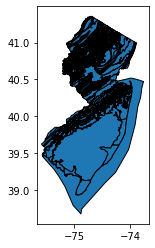

In [4]:
NJ_geol_poly = gpd.read_file(NJ_directory+'/NJ_geol_poly.shp')
ax = NJ_geol_poly.plot(edgecolor='k')

In [6]:
NJ_geol_poly.columns

Index(['STATE', 'ORIG_LABEL', 'SGMC_LABEL', 'UNIT_LINK', 'REF_ID',
       'GENERALIZE', 'SRC_URL', 'URL', 'geometry'],
      dtype='object')

In [7]:
NJ_geol_poly.GENERALIZE.unique()

array(['Metamorphic, sedimentary clastic', 'Sedimentary, carbonate',
       'Metamorphic, undifferentiated', 'Metamorphic, serpentinite',
       'Sedimentary, undifferentiated', 'Sedimentary, clastic',
       'Igneous, intrusive', 'Igneous, volcanic',
       'Unconsolidated, undifferentiated',
       'Metamorphic and Sedimentary, undifferentiated', 'Water',
       'Metamorphic, amphibolite', 'Metamorphic, gneiss',
       'Metamorphic, carbonate'], dtype=object)

,geometry,STATE,ORIG_LABEL,SGMC_LABEL,UNIT_LINK,REF_ID,SRC_URL,URL
GENERALIZE,,,,,,,,
"Igneous, intrusive","MULTIPOLYGON (((-75.03884 40.42936, -75.03809 ...",NJ,Jd,Jd;2,NJJd;2,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...
"Igneous, volcanic","MULTIPOLYGON (((-74.91232 40.46268, -74.90908 ...",NJ,Jh,Jh;5,NJJh;5,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...
"Metamorphic and Sedimentary, undifferentiated","MULTIPOLYGON (((-75.07201 40.66621, -75.07147 ...",NJ,Om,Om;8,NJOm;8,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...
"Metamorphic, amphibolite","MULTIPOLYGON (((-75.12106 40.60569, -75.12033 ...",NJ,Ya,Ya;11,NJYa;11,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...
"Metamorphic, carbonate","MULTIPOLYGON (((-75.06875 40.69107, -75.06895 ...",NJ,Yf,Yf;11,NJYf;11,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...
"Metamorphic, gneiss","MULTIPOLYGON (((-75.18810 40.57671, -75.18712 ...",NJ,Yam,Yam;11,NJYam;11,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...
"Metamorphic, sedimentary clastic","MULTIPOLYGON (((-75.16282 40.58908, -75.16169 ...",NJ,Ch,CAh;6,NJCAh;6,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...
"Metamorphic, serpentinite","POLYGON ((-74.02273 40.72157, -74.02410 40.713...",NJ,CZs,CAZs;10,NJCAZs;10,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...
"Metamorphic, undifferentiated","MULTIPOLYGON (((-74.78294 40.22254, -74.78098 ...",NJ,CZm,CAZm;10,NJCAZm;10,NJ001,http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...


In [17]:
NJ_geol_poly

,STATE,ORIG_LABEL,SGMC_LABEL,UNIT_LINK,REF_ID,GENERALIZE,SRC_URL,URL,geometry
0,NJ,Ch,CAh;6,NJCAh;6,NJ001,"Metamorphic, sedimentary clastic",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-74.82939 40.73351, -74.82994 40.732..."
1,NJ,Ch,CAh;6,NJCAh;6,NJ001,"Metamorphic, sedimentary clastic",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-74.40994 41.07135, -74.41058 41.070..."
2,NJ,Ch,CAh;6,NJCAh;6,NJ001,"Metamorphic, sedimentary clastic",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-74.83298 40.71973, -74.83531 40.718..."
3,NJ,Ch,CAh;6,NJCAh;6,NJ001,"Metamorphic, sedimentary clastic",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-74.72519 40.78465, -74.72734 40.784..."
4,NJ,Ch,CAh;6,NJCAh;6,NJ001,"Metamorphic, sedimentary clastic",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-74.83465 40.72031, -74.83505 40.720..."
...,...,...,...,...,...,...,...,...,...
2634,NJ,Zch,Zch;11,NJZch;11,NJ001,"Metamorphic and Sedimentary, undifferentiated",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-74.92754 40.71721, -74.92839 40.716..."
2635,NJ,Zch,Zch;11,NJZch;11,NJ001,"Metamorphic and Sedimentary, undifferentiated",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-75.17677 40.73125, -75.17879 40.731..."
2636,NJ,Zch,Zch;11,NJZch;11,NJ001,"Metamorphic and Sedimentary, undifferentiated",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-75.18510 40.71633, -75.18526 40.716..."
2637,NJ,Zch,Zch;11,NJZch;11,NJ001,"Metamorphic and Sedimentary, undifferentiated",http://www.state.nj.us/dep/njgs/geodata/dgs04-...,https://mrdata.usgs.gov/geology/state/sgmc-uni...,"POLYGON ((-75.09748 40.78108, -75.09831 40.780..."


In [5]:
import json

geojson = NJ_directory+'/NJ_geol_poly_instrusive.json'
NJ_geol_poly[NJ_geol_poly.GENERALIZE=='Igneous, intrusive'].to_file(geojson, driver = "GeoJSON")
with open(geojson) as geofile: j_file = json.load(geofile)

In [6]:
i=1
for feature in j_file["features"]:
    feature ['id'] = str(i).zfill(2)
    i += 1

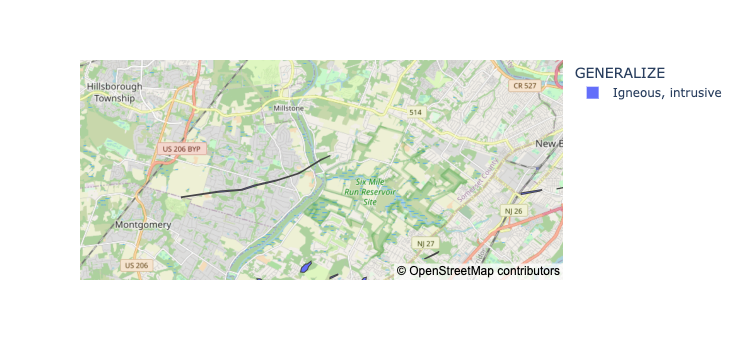

In [ ]:

import plotly.express as px
import geopandas as gpd

df = px.data.election()
geo_df = gpd.GeoDataFrame.from_features(j_file["features"])

fig = px.choropleth_mapbox(geo_df,
                           geojson=geo_df.geometry,
                           locations=geo_df.index,
                           color="GENERALIZE",
                           center={"lat": 40.476322, "lon":-74.572742},
                           mapbox_style="open-street-map",
                           zoom=10.5)
fig.show()

In [ ]:
import shapefile, os,sys
import matplotlib.pyplot as plt
from shapely.geometry import Polygon
from shapely.ops import cascaded_union

# read the arguments
fname=sys.argv[1] # path to physio.shp
outfolder=None
if len(sys.argv)>2:
    outfolder=sys.argv[2] # folder to store output

# read the shapefile
sf = shapefile.Reader(fname)

ShapefileException: Unable to open -f.dbf or -f.shp.

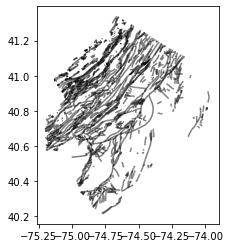

In [10]:

NJ_structure = gpd.read_file(NJ_directory+'/NJ_structure.shp')
ax = NJ_structure.plot(alpha=0.5, edgecolor='k')

In [26]:
NJ_structure.DESCRIPT.unique()

array(['Anticline, certain', 'Anticline, inverted, certain',
       'Anticline, overturned, certain', 'Dike or sill, lamprophyre',
       'Dike or sill, mafic',
       'Fault, sense of displacement unknown or undefined, certain',
       'Fault, sense of displacement unknown or undefined, concealed',
       'Fault, sense of displacement unknown or undefined, inferred or queried',
       'Left lateral fault, certain',
       'Normal fault, approximate, (U/D designated in source)',
       'Normal fault, certain',
       'Normal fault, certain, (U/D designated in source)',
       'Normal fault, concealed',
       'Normal fault, having left lateral oblique slip, certain',
       'Normal fault, inferred or queried, (U/D designated in source)',
       'Right lateral fault, certain', 'Syncline, certain',
       'Syncline, inverted, certain', 'Syncline, overturned, certain',
       'Thrust fault, certain, (teeth on right from origin)',
       'Thrust fault, concealed, (teeth on right from origi

<AxesSubplot:>

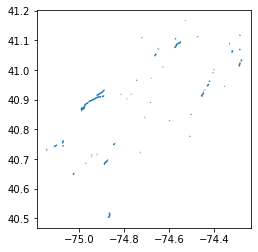

In [47]:
NJ_structure[NJ_structure['DESCRIPT']=='Dike or sill, mafic'].plot()

## Part II: Local Geology Outcrops

Geological mapping of the region and boreholes drilled into the subsurface have revealed unprecendented insights into the stratigraphic formations in the subsurface. The Newark basin is perhaps the most extensively studied of the early Mesozoic basins of eastern North America that formed during the breakup of Pangea. The basin is around 190 km long and a maximum of 50 km wide. In general terms, the basin is bounded on its northwestern and northern margins by a system of mostly normal *border faults*. Along the southeastern and southern margins, Mesozoic rocks rest unconformably on Precambrian and Paleozoic *basement* rocks; in places, Mesozoic rocks are buried by Cretaceous coastal-plain strata. Although disrupted by intrabasinal
faults and warped by transverse folds developed in the hanging
walls of major normal faults, strata generally dip toward the*border faults*. The Newark basin is therefore a classic *half graben*, the fundamental signature of continental extension.

<img src = "Images/half-graben.png" width = "50%" >

*A half-graben is a geological structure bounded by a fault along one side of its boundaries. Source: Wikipedia*  


<img src = "Images/NBxsect1.jpeg" width = "80%" >

*Cross sections of the Newark basin. A-A' and B-B' are the end-points of the cross sections (vertical slices) through the Newark basin. The cross sections immediately beneath the map are shown at the same scale as the geologic map; those in the lower figure are enlarged. The border fault and major internal faults (Flemington-Furlong and Hopewell faults) dip to the southeast; bedding generally dips to the northwest. Post-rift strata pinch out near the edge of the Newark basin. No vertical exaggeration means that the horizontal and vertical scales are the same. Modified from Schlische (1992) and Withjack et al. (2020, 2022). Source: Rutgers University*  

<img src = "Images/NBxsect2.jpeg" width = "80%" >

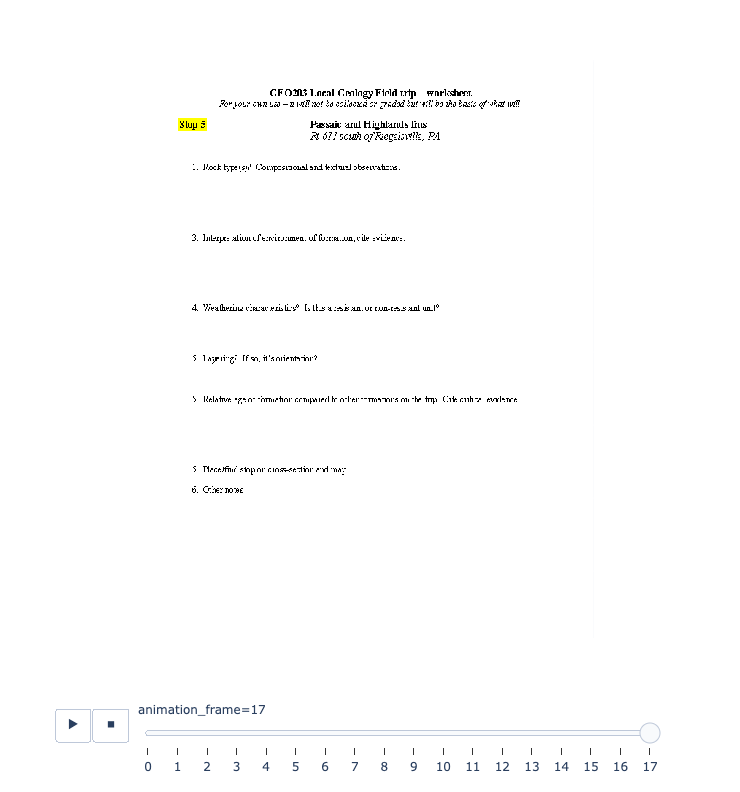

In [86]:
import os,re, IPython
import plotly.express as px
from skimage import io
import numpy as np

# Specify folder containing Slides*.png
folder = 'Files/Field_Guide'

# create list of png files
files = []
for (roots,dirs,file) in os.walk(folder):
    if roots==folder:
        for f in file: 
            if f.endswith('.png'): files.append(f)
files.sort(key=lambda f: int(re.sub('\D','',f))) # sort by number of slide

num_slides = len(files)
for slide in range(0,num_slides):
    image_file = folder+'/Field_Guide_Page_'+f"{(slide+1):02d}"+'.png'
    img = io.imread(image_file)
    if len(img.shape) == 2: img = color.gray2rgb(img) # convert b/w to rgb
    
    #slide_deck.shape (Nimg, y, x) for monochrome. (Nimg, y, x, 3) for RGB color.
    if slide == 0: slide_deck = np.zeros([num_slides,img.shape[0],img.shape[1],img.shape[2]])
    slide_deck[slide] = img
    
fig = px.imshow(slide_deck, animation_frame=0,binary_string=True, 
                binary_format='png', binary_compression_level=3,
                width=img.shape[1], height=img.shape[0])
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 2000
fig.show()    

### Review of rock characteristics and classification

**Rock composition:** the minerals, fossils, and other material that make up a rock. Rock composition gives information about the source material for the rock, as well as about processes that occurred during rock formation. In the field, composition is mostly based on identifying the minerals present in a rock. When mineral grains are large, this is relatively easy if you are familiar with a dozen or so common rock-forming minerals. When grains are small, this is difficult but you can often use color to give you general clues about composition. 

**Rock texture:** how the compositional components of a rock are put together. Rock texture gives much information about processes that occurred during rock formation. Train your eye by considering three important observations:

- *Is the rock layered?*  Most sedimentary rocks are layered. Most igneous rocks are not layered. Metamorphic rocks can be layered or unlayered. 

- *Does the rock have clastic or crystalline texture?* In clastic rocks, discrete grains are held together by cementing material between the grains. In crystalline rocks, mineral grains are intergrown so that their grain boundaries interfinger in a jigsaw-puzzle type pattern. N.B. If grains are too small, you can’t make this observation with your naked eye. Most sedimentary rocks are clastic, with the exception of chemical sediments that precipitate out of water. Virtually all igneous and metamorphic rocks are crystalline. 

- *What is the grain size or range of grain sizes in the rock?* Once a rock has been classified by igneous, metamorphic, or sedimentary, further classification is partly based on grain size.


**Common sedimentary rocks** (mostly clastic, some limestones are crystalline):

*Limestone*: comprised primarily of the mineral calcite (CaCO3, applying acid will result in the formation of bubbles (release of CO2 gas)). Calcite occurs as fossils (shells, etc.) and/or as a chemical sediment formed by precipitating out of water. Dolostone (dolomite) is similar to limestone, but some of the Ca is replaced by Mg. This rock only bubbles if pulverized into small particles before HCl is applied.

*Shale*: clastic sedimentary rock comprised of clay particles too small to see with the naked eye. Usually a soft, finely-layered rock that looks like compressed mud. 

*Sandstone*: clastic sedimentary rock comprised of sand grains or other sand-sized particles that be been cemented together. Usually gritty to the touch. 

*Conglomerate*: clastic sedimentary rock comprised of poorly-sorted particles of a variety of sizes (clay, sand, pebbles) that have been cemented together.

 
**Common metamorphic rocks** (crystalline texture; can be layered or unlayered):

*Slate*: finely-layered rock which splits parallel to the alignment of fine-grained platy minerals (micas)

*Schist*: coarser-grained rock with layering defined by parallel alignment of micas

*Gneiss*: coarse- grained rock characterized bysegregation of minerals into different layers

*Marble*: metamorphic rock comprised primarily of calcite

*Quartzite*: metamorphic rock comprised primarily of quartz


**Principles of relative dating of geologic structures and events**:

*Principle of original horizontality of sedimentary layering* - sediments are deposited as horizontal layers

*Principle of superposition of undeformed sedimentary layering* - oldest on the bottom

*Principle of igneous intrusions* - intrusions must be younger that the rocks they intrude

*Principle of cross-cutting relationships* – structures must be younger than structures/rock units they cut

### Overview of stops and worksheets to be used on the trip.

Geological mapping of the region and boreholes drilled into the subsurface have revealed unprecendented insights into the stratigraphic formations in the subsurface. The Newark basin is perhaps the most extensively studied of the early Mesozoic basins of eastern North America that formed during the breakup of Pangea. The basin is around 190 km long and a maximum of 50 km wide. In general terms, the basin is bounded on its northwestern and northern margins by a system of mostly normal *border faults*. Along the southeastern and southern margins, Mesozoic rocks rest unconformably on Precambrian and Paleozoic *basement* rocks; in places, Mesozoic rocks are buried by Cretaceous coastal-plain strata. Although disrupted by intrabasinal faults and warped by transverse folds developed in the hanging
walls of major normal faults, strata generally dip toward the*border faults*. The Newark basin is therefore a classic *half graben*, the fundamental signature of continental extension.

<img src = "Images/OverviewStops.jpg" width = "70%" >

*Overview of stops during the day*

<img src = "Images/Stops.jpg" width = "70%" >

Here's the generic worksheet we will be using during the field tirp.; you'll be given one (hard copy) for each stop to work on during the trip.  These will not collected nor graded, but will be the basis on which you'll answer the required questions.  Take advantage of the sheets, fill out everything, ask questions, make connections.

<img src = "Files/generic_worksheet.jpg" width = "40%">

#### Stop 1: Stockton Formation along Washington Rd



In [81]:
from IPython.display import IFrame


IFrame("https://www.google.com/maps/embed?pb=!1m18!1m12!1m3!1d3041.038764576202!2d-74.65215068476462!3d40.3414860681365!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!3m3!1m2!1s0x0%3A0x49deae4d8e2f832d!2zNDDCsDIwJzI5LjMiTiA3NMKwMzgnNTkuOSJX!5e0!3m2!1sen!2sus!4v1667420508465!5m2!1sen!2sus",width=400, height=250)


#### Stop 2: Lockatong/Passaic formation (at Princeton Professional Center)



In [82]:
from IPython.display import IFrame


IFrame("https://www.google.com/maps/embed?pb=!1m18!1m12!1m3!1d3041.038764576202!2d-74.65215068476462!3d40.3414860681365!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!3m3!1m2!1s0x0%3A0x49deae4d8e2f832d!2zNDDCsDIwJzI5LjMiTiA3NMKwMzgnNTkuOSJX!5e0!3m2!1sen!2sus!4v1667420508465!5m2!1sen!2sus",width=400, height=250)


#### Stop 3: Lockatong and Rocky Hill formations (at Herrontown Woods)



In [83]:
from IPython.display import IFrame


IFrame("https://www.google.com/maps/embed?pb=!1m18!1m12!1m3!1d3039.4653410273368!2d-74.6426566847638!3d40.37637806601681!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!3m3!1m2!1s0x0%3A0xcad328e808841090!2zNDDCsDIyJzM1LjAiTiA3NMKwMzgnMjUuNyJX!5e0!3m2!1sen!2sus!4v1667500268784!5m2!1sen!2sus",width=400, height=250)


#### Stop 4: Passaic formation (along Rte 619 north of Frenchtown, NJ)



In [84]:
from IPython.display import IFrame


IFrame("https://www.google.com/maps/embed?pb=!1m18!1m12!1m3!1d3031.694839125641!2d-75.07117876941456!3d40.54833062901744!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!3m3!1m2!1s0x0%3A0x183a653e9a8f9e7d!2zNDDCsDMyJzU2LjIiTiA3NcKwMDQnMDguNSJX!5e0!3m2!1sen!2sus!4v1667499954835!5m2!1sen!2sus",width=400, height=250)


#### Stop 5A and 5B: Passaic and Highlands formations (along Rte 611 south of Riegelsville, PA



In [85]:
from IPython.display import IFrame


IFrame("https://www.google.com/maps/embed?pb=!1m18!1m12!1m3!1d3030.5940058393235!2d-75.19476368475819!3d40.57264205406659!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!3m3!1m2!1s0x0%3A0xbca6eb451f967d2f!2zNDDCsDM0JzIxLjUiTiA3NcKwMTEnMzMuMyJX!5e0!3m2!1sen!2sus!4v1667498676091!5m2!1sen!2sus",width=400, height=250)


### TO DO

**Question 2.1**.  We saw four geologic formations today:  Stockton, Passaic, Rocky Hill, Highlands.  Make a list, with the youngest formation at the top of the list and the others in progressively order of age with the oldest at the bottom.  In a few sentences name and describe the rock type(s) of each formation.

**Answer:**

<br><br/>
<br><br/>

**Question 2.2** Compare/contrast the Passaic formation you saw at Stop 4 (Frenchtown) and Stop 5 (Riegelsville).  The rocks are of similar age, and both lie within the Newark rift basin that marks the initial breakup of Pangea.  There are no major faults or other deformational structures between them.  Yet the rocks at the two stops have different rock types and sedimentary structures.  What are the differences, and why are the rocks so different at these two places.

**Answer:**

<br><br/>
<br><br/>

**Question 2.3** Describe evidence for the “Border Fault” at Stop 5.  The fault itself is not exposed.  What is the evidence that there is a fault there, and that there is a major amount of displacement along it?

**Answer:**

<br><br/>
<br><br/>

**Question 2.4** In bullet-list form, summarize the sequential geologic history of the area based on your observations and our discussions during the trip.  Your list should include the formation of the various geologic units, igneous events, deformation events, and should end with something like “erosion, exposure and formation of the modern topography.”

**Answer:**

<br><br/>
<br><br/>

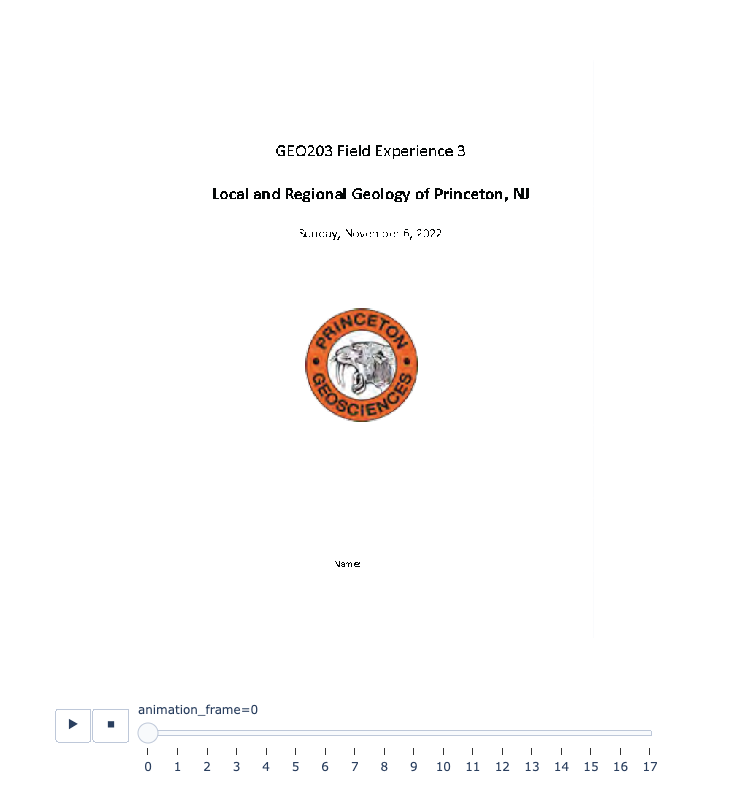

In [80]:
import os,re, IPython
import plotly.express as px
from skimage import io,color
import numpy as np

# Specify folder containing Slides*.png
folder = 'Files/Field_Guide'

# create list of png files
files = []
for (roots,dirs,file) in os.walk(folder):
    if roots==folder:
        for f in file: 
            if f.endswith('.png'): files.append(f)
files.sort(key=lambda f: int(re.sub('\D','',f))) # sort by number of slide

num_slides = len(files)
for slide in range(0,num_slides):
    image_file = folder+'/Field_Guide_Page_'+f"{(slide+1):02d}"+'.png'
    img = io.imread(image_file)
    if len(img.shape) == 2: img = color.gray2rgb(img) # convert b/w to rgb
    
    #slide_deck.shape (Nimg, y, x) for monochrome. (Nimg, y, x, 3) for RGB color.
    if slide == 0: slide_deck = np.zeros([num_slides,img.shape[0],img.shape[1],img.shape[2]])
    try:
        slide_deck[slide] = img
    except:
        print(image_file)
    
fig = px.imshow(slide_deck, animation_frame=0,binary_string=True, 
                binary_format='png', binary_compression_level=3,
                width=img.shape[1], height=img.shape[0])
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 2000
fig.show()    